In [1]:
import tensorflow as tf
from tensorflow.keras import layers, losses, Model, optimizers, utils, preprocessing
import os
from matplotlib import pyplot as plt

In [2]:
from IPython.display import display


# Get Dataset

In [3]:
dataset_url = "http://www.eecs.berkeley.edu/Research/Projects/CS/vision/grouping/BSR/BSR_bsds500.tgz"
data_dir = utils.get_file(origin=dataset_url, fname="BSR", untar=True)
root_dir = os.path.join(data_dir, "BSDS500/data")

In [4]:
crop_size = 300
upscale_factor = 4
# input_size = crop_size // upscale_factor
input_size = crop_size
batch_size = 32

train_ds = preprocessing.image_dataset_from_directory(
    root_dir,
    batch_size=batch_size,
    image_size=(crop_size, crop_size),
    validation_split=0.2,
    subset="training",
    seed=1337,
    label_mode=None,
)

valid_ds = preprocessing.image_dataset_from_directory(
    root_dir,
    batch_size=batch_size,
    image_size=(crop_size, crop_size),
    validation_split=0.2,
    subset="validation",
    seed=1337,
    label_mode=None,
)

Found 500 files belonging to 1 classes.
Using 400 files for training.
Metal device set to: Apple M2

systemMemory: 8.00 GB
maxCacheSize: 2.67 GB

Found 500 files belonging to 1 classes.
Using 100 files for validation.


# Preprocessing the images

In [5]:
def scaling(input_image):
    input_image = input_image / 255.0
    return input_image


# Scale from (0, 255) to (0, 1)
train_ds = train_ds.map(scaling)
valid_ds = valid_ds.map(scaling)

In [6]:
# for batch in train_ds.take(1):
#     for img in batch:
#         display(utils.array_to_img(img))

In [7]:
def process_input(input, input_size, upscale_factor):
    downsample = tf.image.resize(input, [input_size//upscale_factor, input_size//upscale_factor], method="area")
    interpolate =  tf.image.resize(downsample, [input_size, input_size], method="bicubic")
    return interpolate

def process_target(input):
    # Identity mapping
    return input

train_ds = train_ds.map(
    lambda x: (process_input(x, input_size, upscale_factor), process_target(x))
)
train_ds = train_ds.prefetch(buffer_size=32)

valid_ds = valid_ds.map(
    lambda x: (process_input(x, input_size, upscale_factor), process_target(x))
)
valid_ds = valid_ds.prefetch(buffer_size=32)

2023-05-24 08:47:17.699512: W tensorflow/tsl/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


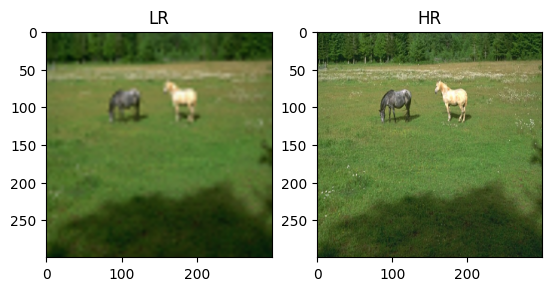

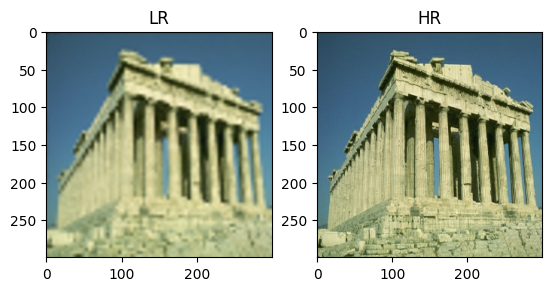

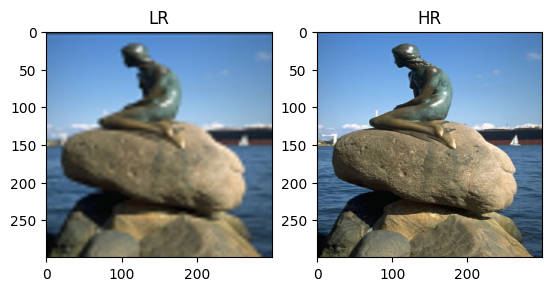

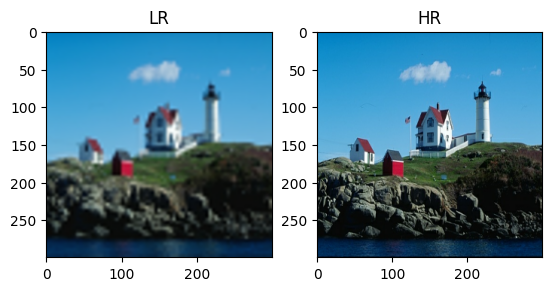

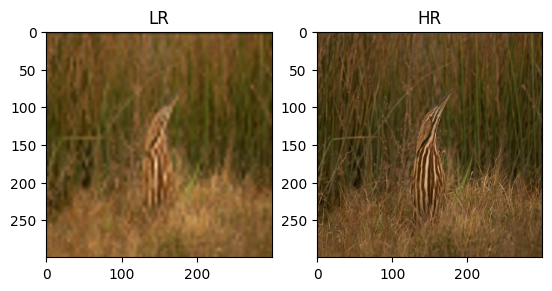

...

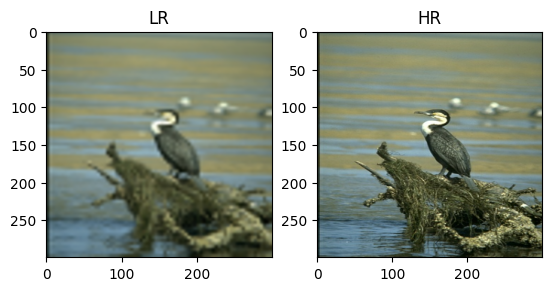

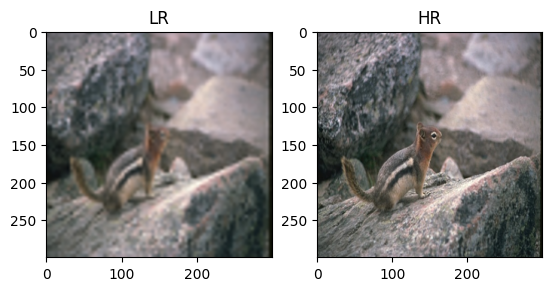

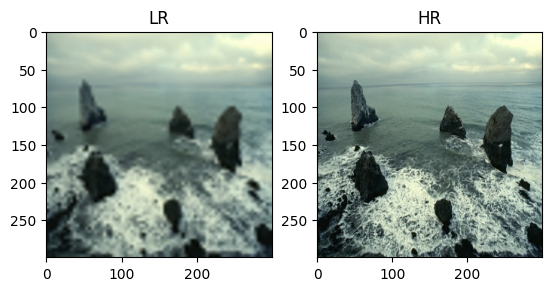

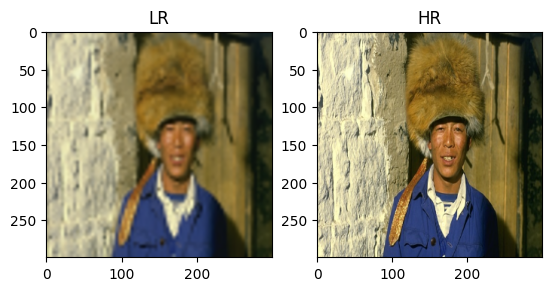

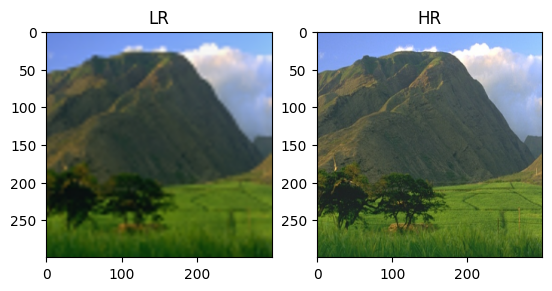

In [8]:
for batch in train_ds.take(1):
    for lr, hr in zip(batch[0], batch[1]):
        plt.subplot(1, 2, 1)
        plt.title("LR")
        plt.imshow(utils.array_to_img(lr))
        
        plt.subplot(1, 2, 2)
        plt.title("HR")
        plt.imshow(utils.array_to_img(hr))
        plt.show()
    # for img in batch[0]:
    #     display(utils.array_to_img(img))
    # for img in batch[1]:
    #     display(utils.array_to_img(img))

# Helper functions

In [23]:
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
import PIL
import numpy as np


def plot_results(img, prefix, title):
    """Plot the result with zoom-in area."""
    img_array = utils.img_to_array(img)
    img_array = img_array.astype("float32") / 255.0

    # Create a new figure with a default 111 subplot.
    fig, ax = plt.subplots()
    im = ax.imshow(img_array[::-1], origin="lower")

    plt.title(title)
    # zoom-factor: 2.0, location: upper-left
    axins = zoomed_inset_axes(ax, 2, loc=2)
    axins.imshow(img_array[::-1], origin="lower")

    # Specify the limits.
    # x1, x2, y1, y2 = 60, 80, 40, 60
    x1, x2, y1, y2 = 200, 300, 100, 200

    # Apply the x-limits.
    axins.set_xlim(x1, x2)
    # Apply the y-limits.
    axins.set_ylim(y1, y2)

    plt.yticks(visible=False)
    plt.xticks(visible=False)

    # Make the line.
    mark_inset(ax, axins, loc1=1, loc2=3, fc="none", ec="blue")
    plt.savefig(str(prefix) + "-" + title + ".png")
    plt.show()


def get_lowres_image(img, upscale_factor):
    """Return low-resolution image to use as model input."""
    return img.resize(
        (img.size[0] // upscale_factor, img.size[1] // upscale_factor),
        PIL.Image.BICUBIC,
    )


def upscale_image(model, img):
    """Predict the result based on input image and restore the image as RGB."""
    
    y = utils.img_to_array(img)
    y = y.astype("float32") / 255.0

    input = tf.expand_dims(y, axis=0)
    out = model.predict(input)

    out_img_y = out[0]
    # out_img_y *= 255.0
    out_img_y = (out_img_y+1)*127.5

    return out_img_y

In [24]:
root_dir

'/Users/raunavghosh/.keras/datasets/BSR/BSDS500/data'

In [25]:
dataset = os.path.join(root_dir, "images")
test_path = os.path.join(dataset, "test")

test_img_paths = sorted(
    [
        os.path.join(test_path, fname)
        for fname in os.listdir(test_path)
        if fname.endswith(".jpg")
    ]
)

In [26]:
test_img_paths[:3]

['/Users/raunavghosh/.keras/datasets/BSR/BSDS500/data/images/test/100007.jpg',
 '/Users/raunavghosh/.keras/datasets/BSR/BSDS500/data/images/test/100039.jpg',
 '/Users/raunavghosh/.keras/datasets/BSR/BSDS500/data/images/test/100099.jpg']

# SRResNet

In [27]:
srresnet = tf.keras.models.load_model("./SRResNet-mse.h5")
srresnet.summary()

/Users/raunavghosh/miniconda3/envs/tf/lib/python3.10/site-packages/keras/layers/core/lambda_layer.py:325: UserWarning: models is not loaded, but a Lambda layer uses it. It may cause errors.
  function = cls._parse_function_from_config(


Model: "Generator"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   15616       ['input_1[0][0]']                
                                64)                                                               
                                                                                                  
 p_re_lu (PReLU)                (None, None, None,   64          ['conv2d[0][0]']                 
                                64)                                                       

1/1 [==============================] - 1s 876ms/step
254.98952 17.804537
PSNR of low resolution image and high resolution image is 28.8871
PSNR of predict and high resolution is 24.0671


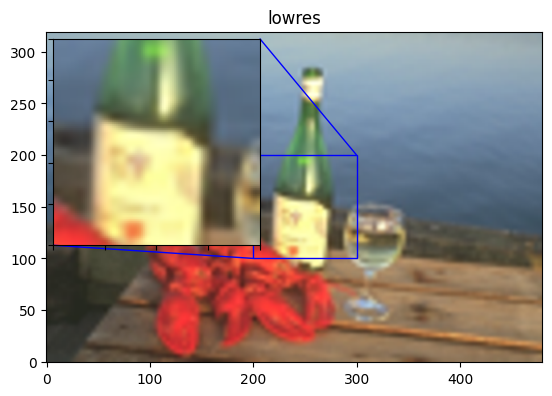

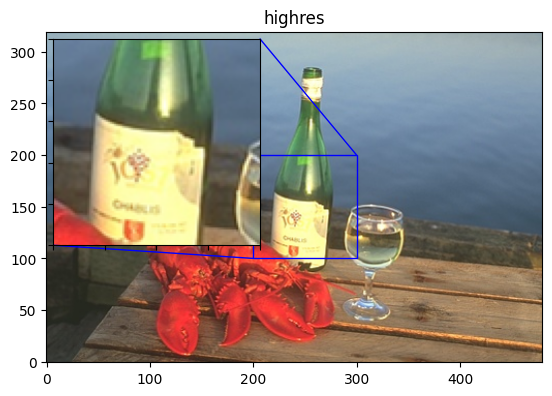

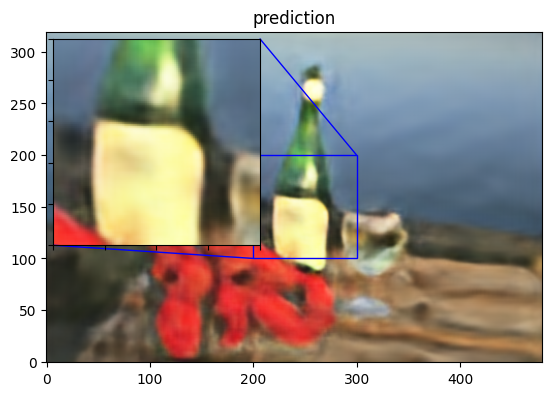

1/1 [==============================] - 0s 52ms/step
254.99991 18.44421
PSNR of low resolution image and high resolution image is 23.7495
PSNR of predict and high resolution is 19.1455


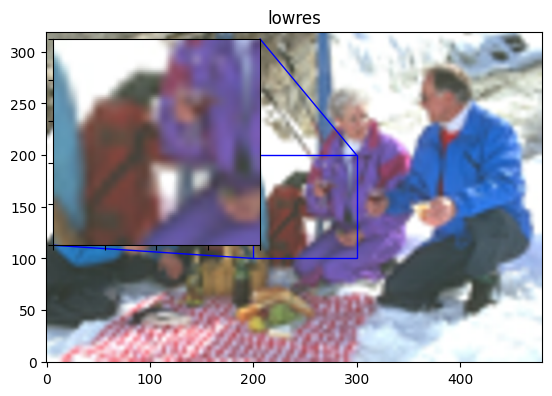

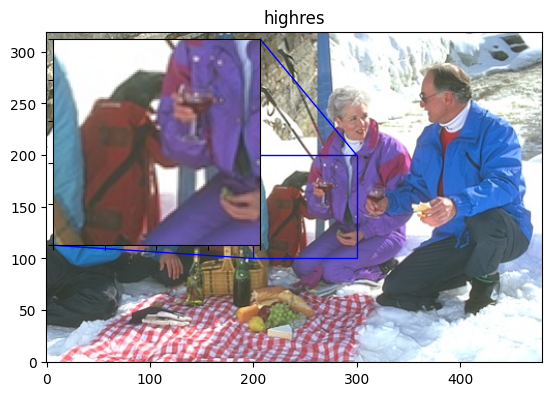

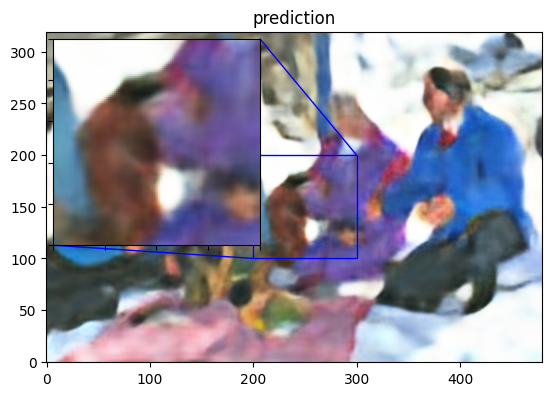

1/1 [==============================] - 1s 612ms/step
254.99174 0.17802045
PSNR of low resolution image and high resolution image is 26.3186
PSNR of predict and high resolution is 20.4595


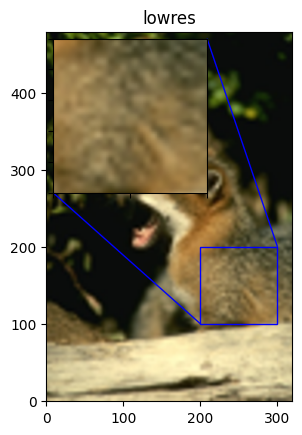

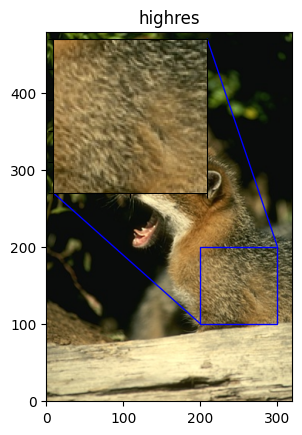

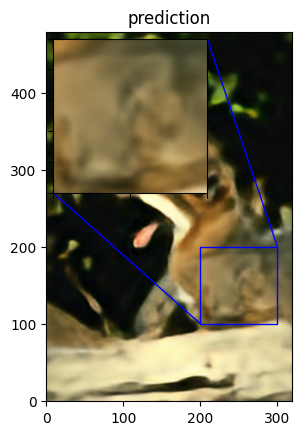

1/1 [==============================] - 0s 39ms/step
223.48645 2.3244796
PSNR of low resolution image and high resolution image is 27.6824
PSNR of predict and high resolution is 24.3320


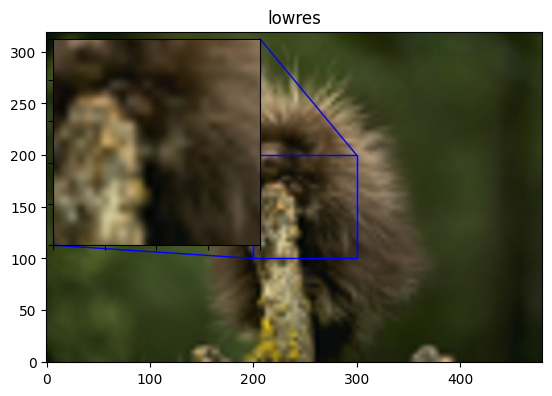

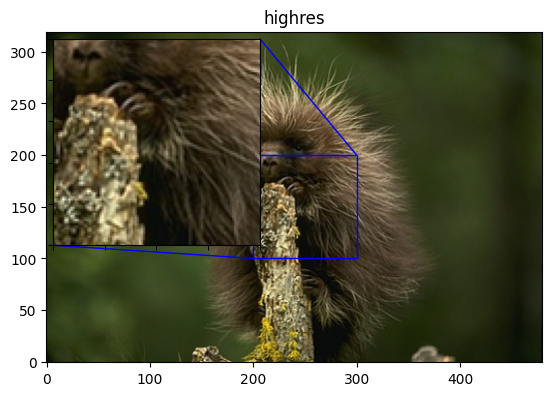

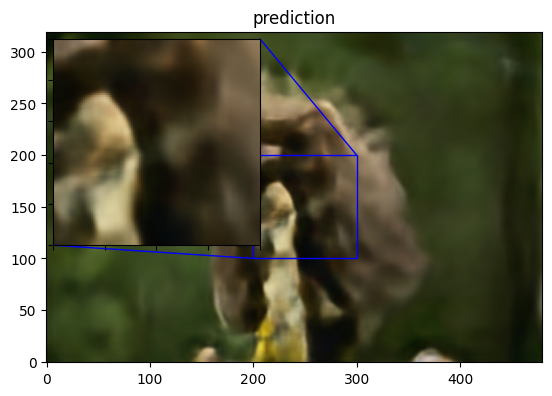

1/1 [==============================] - 0s 65ms/step
254.9992 11.94301
PSNR of low resolution image and high resolution image is 24.7265
PSNR of predict and high resolution is 20.0143


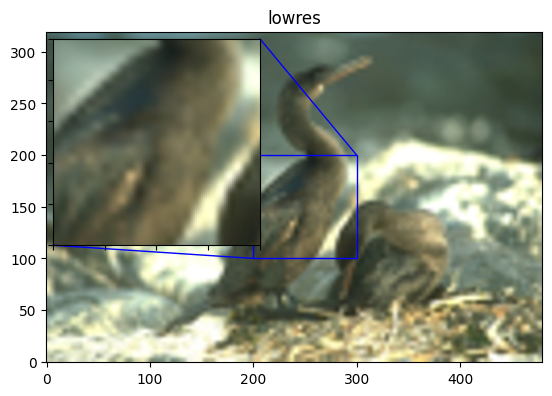

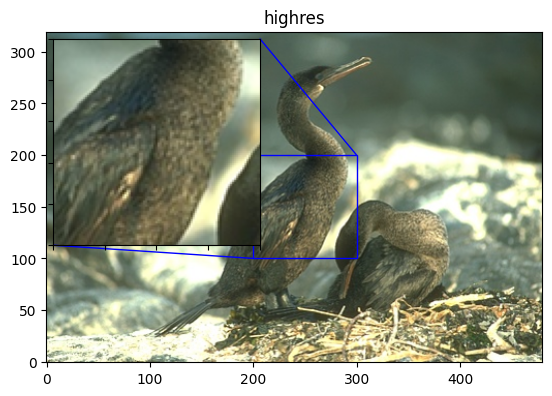

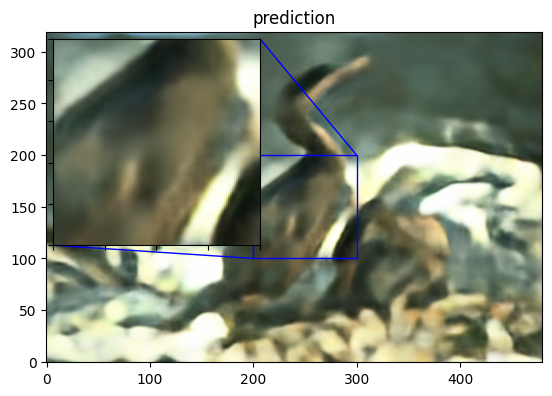

1/1 [==============================] - 0s 25ms/step
254.99976 0.30508563
PSNR of low resolution image and high resolution image is 24.7180
PSNR of predict and high resolution is 19.5961


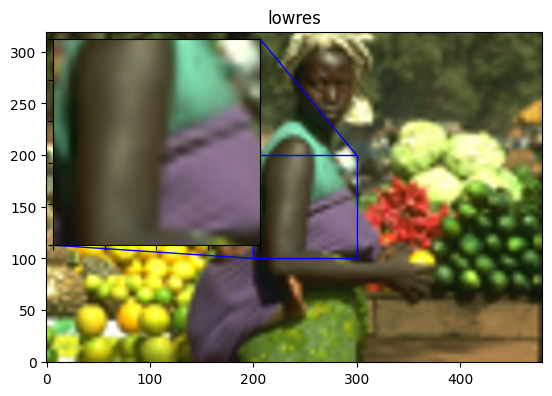

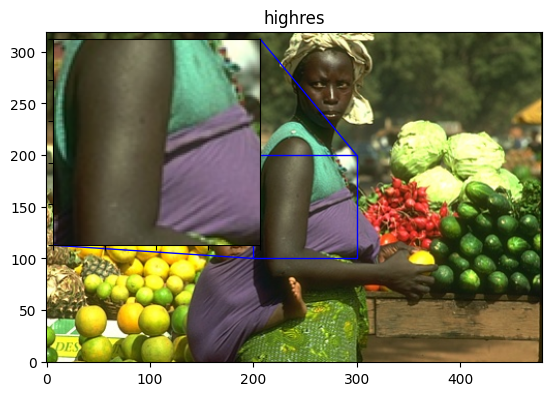

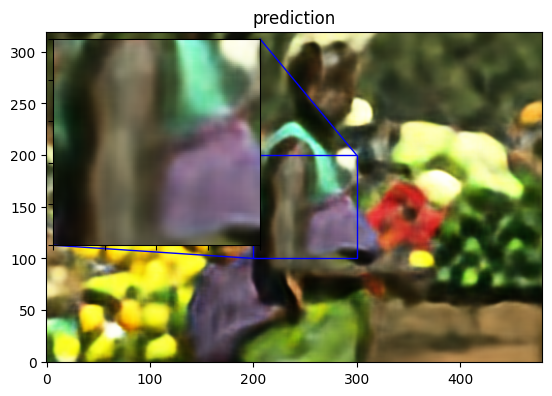

1/1 [==============================] - 0s 37ms/step
254.18129 1.5553325
PSNR of low resolution image and high resolution image is 24.7138
PSNR of predict and high resolution is 19.8107


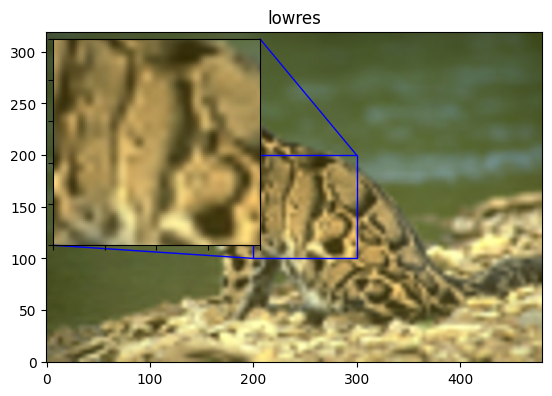

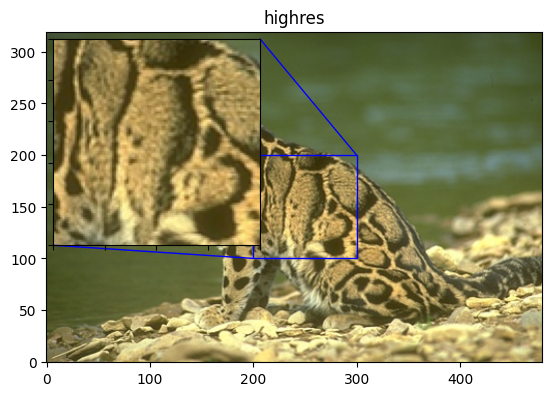

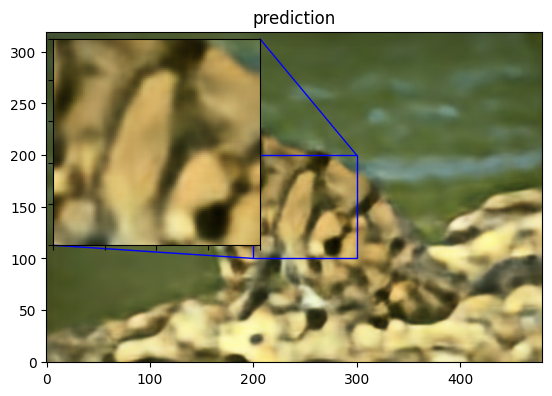

1/1 [==============================] - 0s 24ms/step
254.51439 5.000456
PSNR of low resolution image and high resolution image is 21.9633
PSNR of predict and high resolution is 18.2406


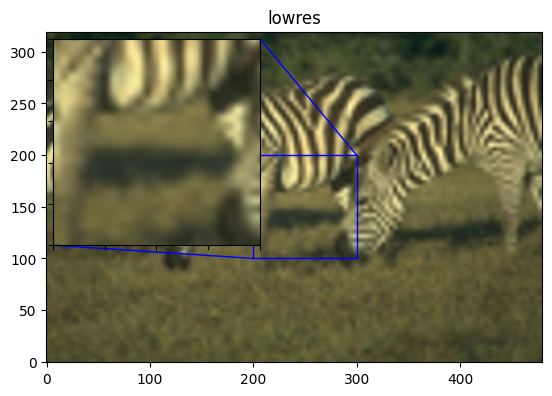

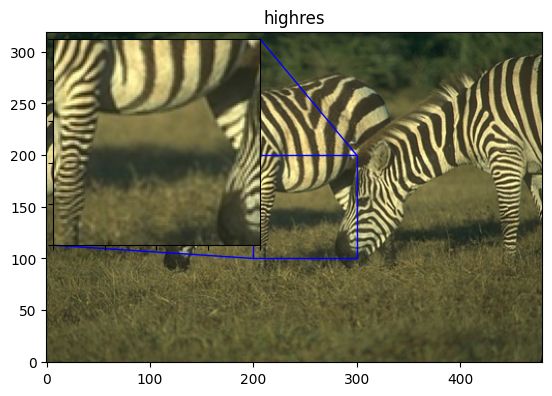

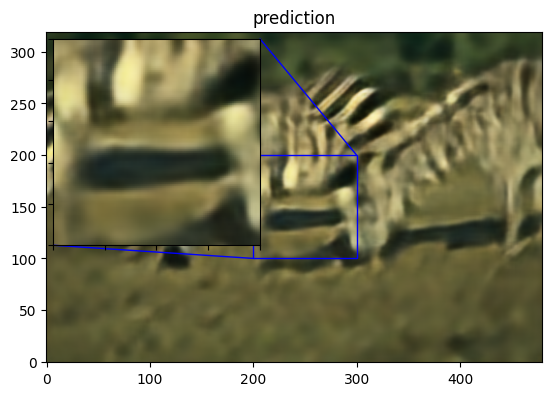

1/1 [==============================] - 0s 25ms/step
217.58629 3.8508806
PSNR of low resolution image and high resolution image is 29.4021
PSNR of predict and high resolution is 25.5795


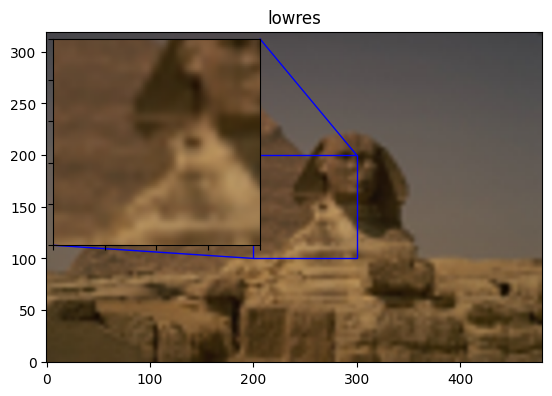

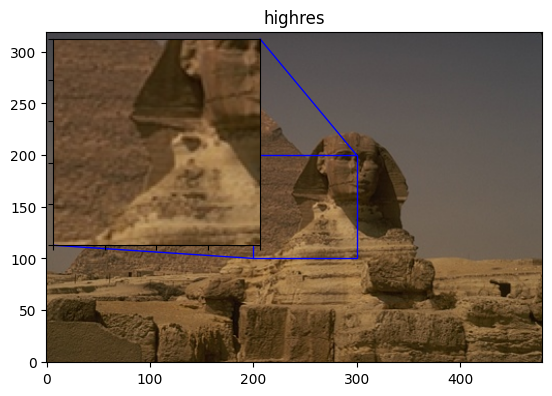

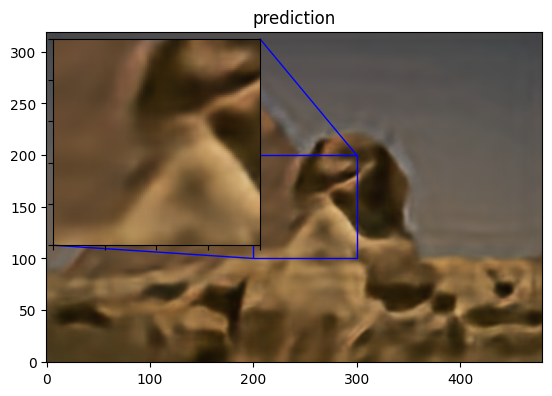

1/1 [==============================] - 0s 58ms/step
254.90558 0.5124937
PSNR of low resolution image and high resolution image is 24.3273
PSNR of predict and high resolution is 20.3313


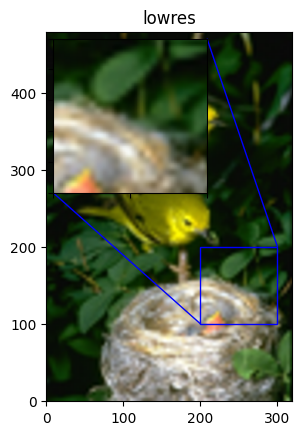

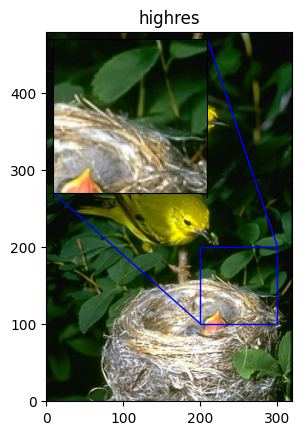

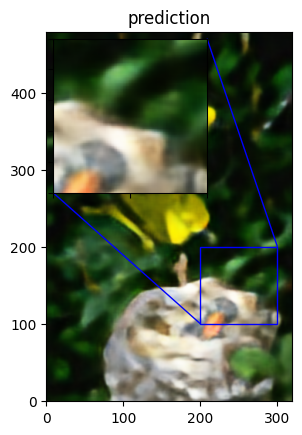

Avg. PSNR of lowres images is 25.6489
Avg. PSNR of reconstructions is 21.1577


In [28]:
total_bicubic_psnr = 0.0
total_test_psnr = 0.0

for index, test_img_path in enumerate(test_img_paths[50:60]):
    img = utils.load_img(test_img_path)
    lowres_input = get_lowres_image(img, upscale_factor)
    w = lowres_input.size[0] * upscale_factor
    h = lowres_input.size[1] * upscale_factor
    highres_img = img.resize((w, h))
    lowres_img = lowres_input.resize((w, h))
    lowres_input_arr = utils.img_to_array(lowres_input)
    prediction = upscale_image(srresnet, lowres_input_arr)
    lowres_img_arr = utils.img_to_array(lowres_img)
    highres_img_arr = utils.img_to_array(highres_img)
    predict_img_arr = utils.img_to_array(prediction)
    print(np.max(predict_img_arr), np.min(predict_img_arr))
    bicubic_psnr = tf.image.psnr(lowres_img_arr, highres_img_arr, max_val=255)
    # print(lowres_img_arr.shape, highres_img_arr.shape)
    test_psnr = tf.image.psnr(predict_img_arr, highres_img_arr, max_val=255)

    total_bicubic_psnr += bicubic_psnr
    total_test_psnr += test_psnr

    print(
        "PSNR of low resolution image and high resolution image is %.4f" % bicubic_psnr
    )
    print("PSNR of predict and high resolution is %.4f" % test_psnr)
    plot_results(lowres_img, index, "lowres")
    plot_results(highres_img, index, "highres")
    plot_results(prediction, index, "prediction")

print("Avg. PSNR of lowres images is %.4f" % (total_bicubic_psnr / 10))
print("Avg. PSNR of reconstructions is %.4f" % (total_test_psnr / 10))

# SRGAN

In [30]:
from models import build_discriminator, build_generator, VGG_54, MySRGAN

In [38]:
crop_size = 96
generator = build_generator()
discriminator = build_discriminator(hr_shape=(crop_size,crop_size,3))
vgg54 = VGG_54()
srgan = MySRGAN(generator, discriminator, vgg54)
srgan.build((1, 24, 24, 3))
srgan.load_weights("./SRGAN-phase2.h5")
# generator = srgan.generator
# generator.summary()

1/1 [==============================] - 1s 913ms/step
253.39845 9.550796
PSNR of low resolution image and high resolution image is 28.8871
PSNR of predict and high resolution is 22.1804


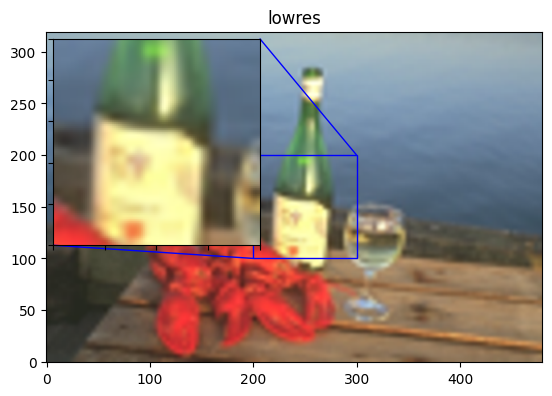

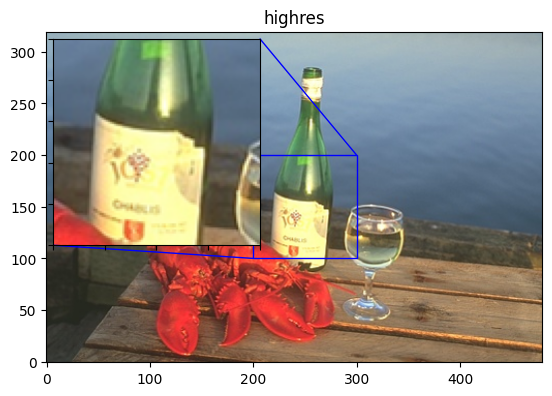

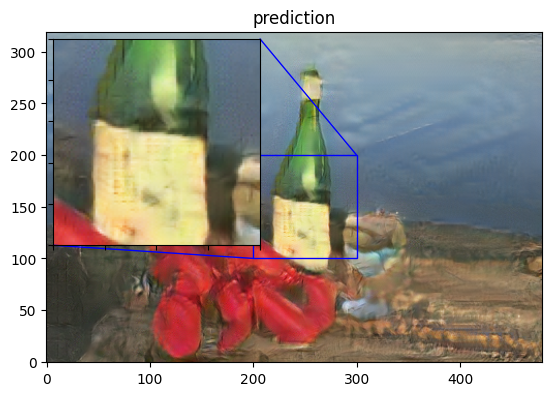

1/1 [==============================] - 0s 56ms/step
254.9371 10.118302
PSNR of low resolution image and high resolution image is 23.7495
PSNR of predict and high resolution is 17.2763


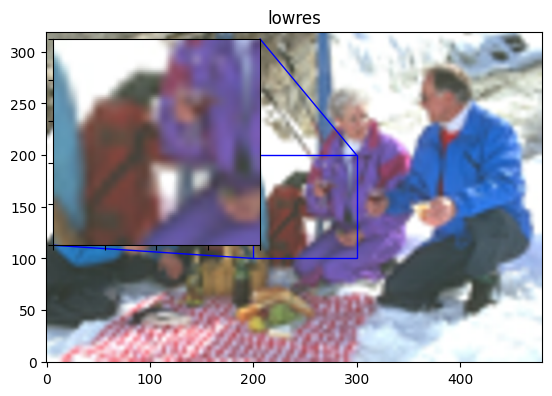

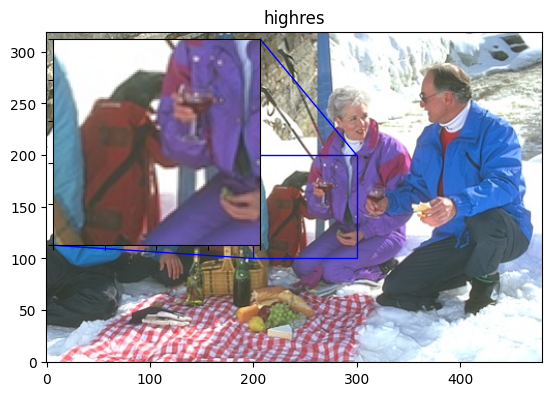

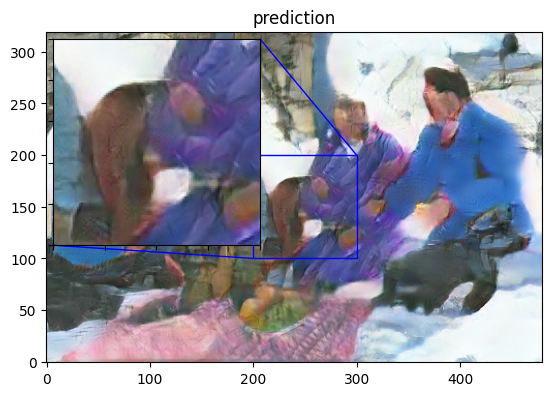

1/1 [==============================] - 1s 679ms/step
250.99872 0.1305458
PSNR of low resolution image and high resolution image is 26.3186
PSNR of predict and high resolution is 19.0545


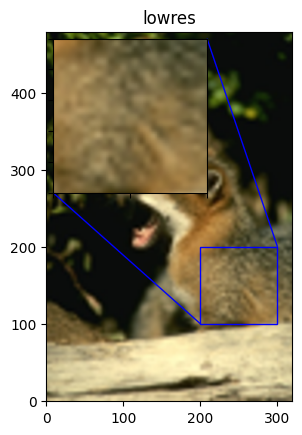

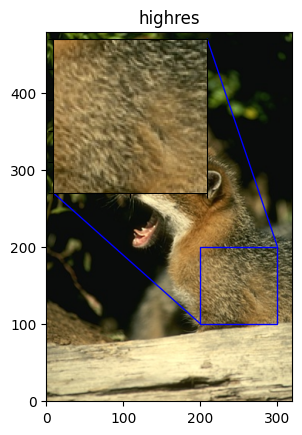

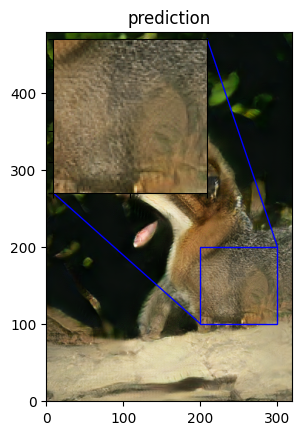

1/1 [==============================] - 0s 28ms/step
220.68237 2.5329442
PSNR of low resolution image and high resolution image is 27.6824
PSNR of predict and high resolution is 22.5760


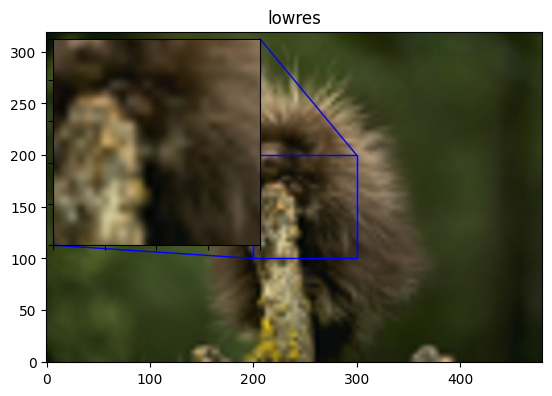

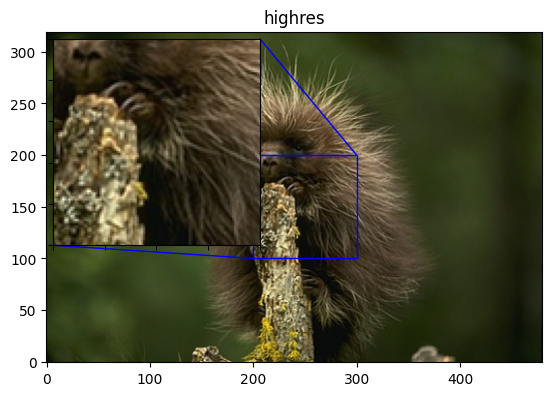

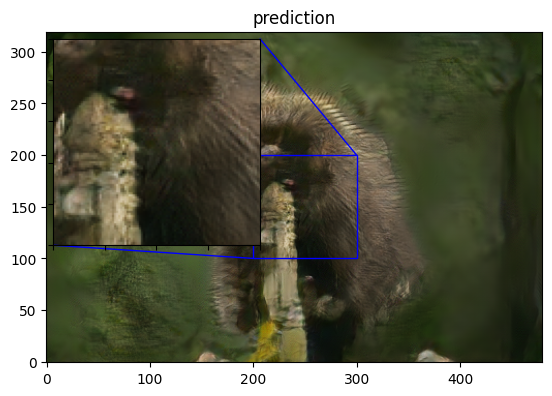

1/1 [==============================] - 0s 26ms/step
254.98416 10.762261
PSNR of low resolution image and high resolution image is 24.7265
PSNR of predict and high resolution is 18.7835


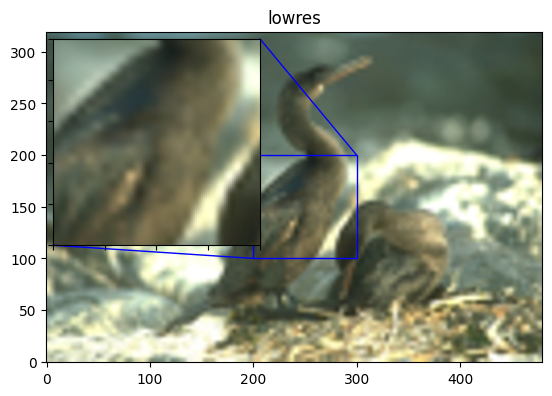

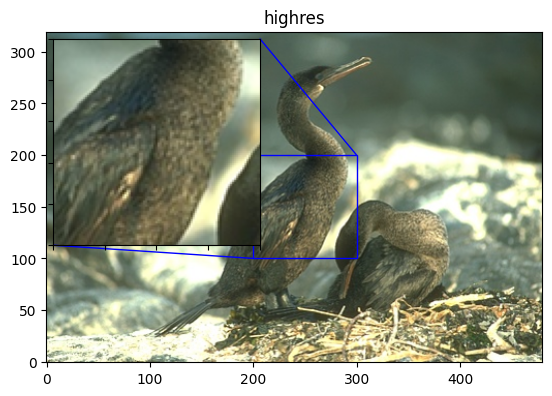

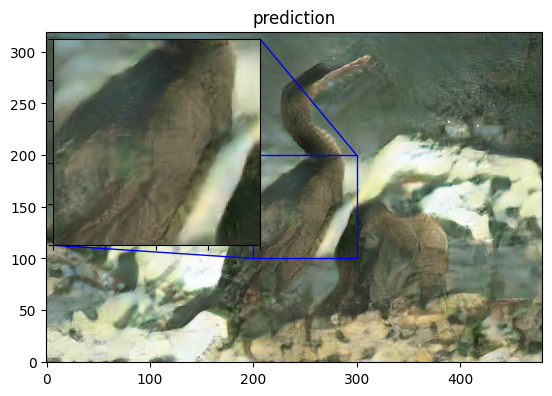

1/1 [==============================] - 0s 72ms/step
254.94032 0.24838507
PSNR of low resolution image and high resolution image is 24.7180
PSNR of predict and high resolution is 18.0847


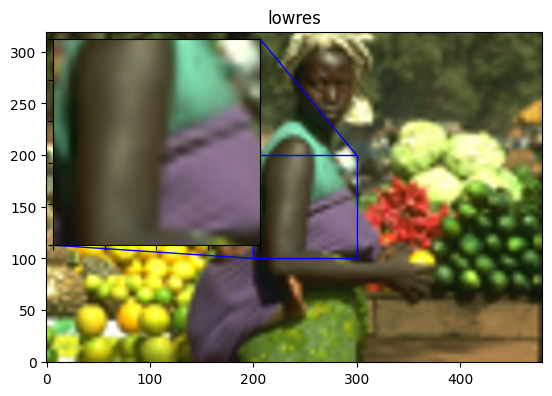

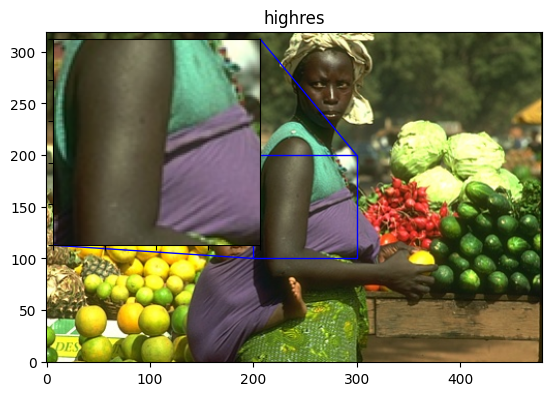

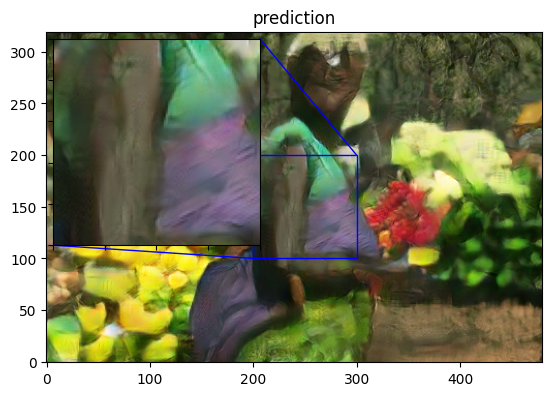

1/1 [==============================] - 0s 31ms/step
247.80707 1.6738178
PSNR of low resolution image and high resolution image is 24.7138
PSNR of predict and high resolution is 18.4960


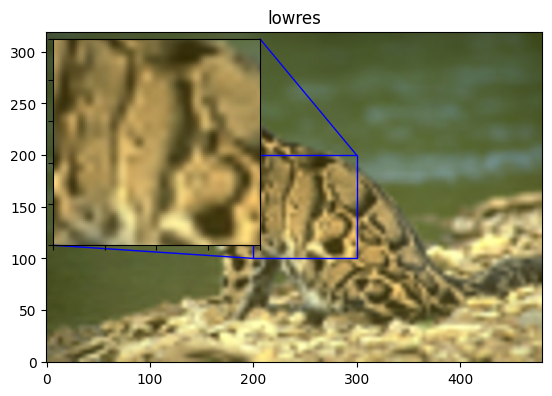

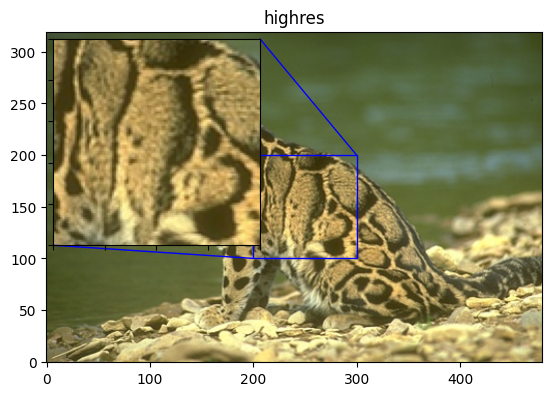

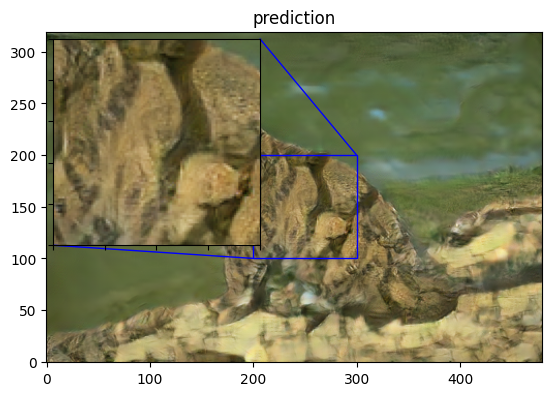

1/1 [==============================] - 0s 66ms/step
248.58209 3.3095996
PSNR of low resolution image and high resolution image is 21.9633
PSNR of predict and high resolution is 16.8936


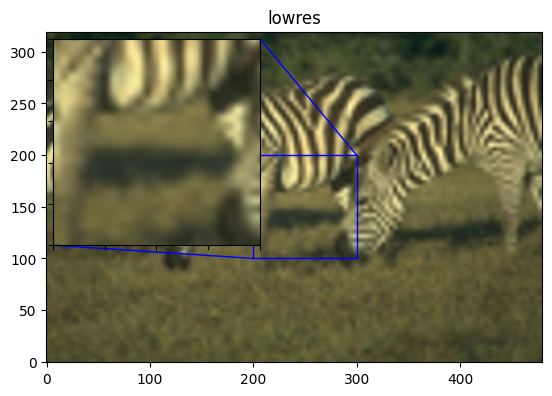

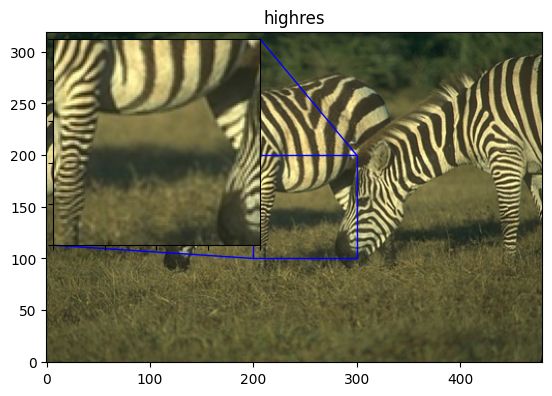

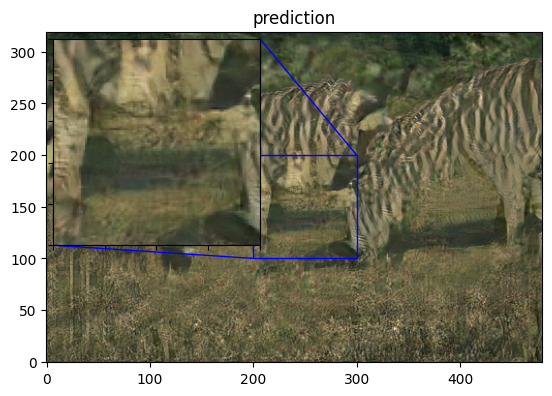

1/1 [==============================] - 0s 28ms/step
185.76639 4.449455
PSNR of low resolution image and high resolution image is 29.4021
PSNR of predict and high resolution is 24.5506


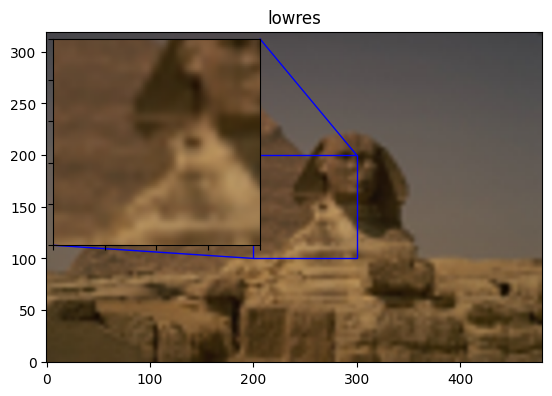

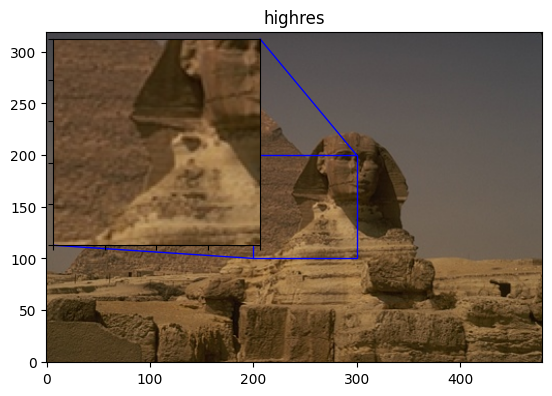

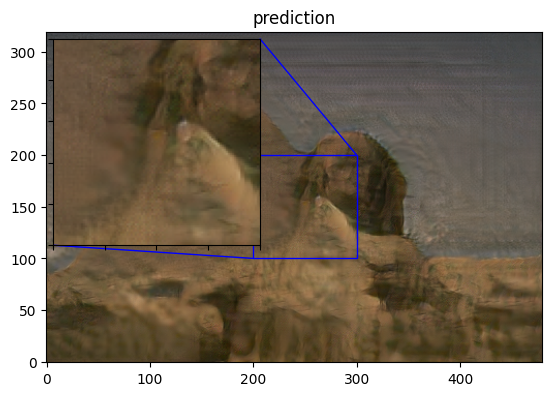

1/1 [==============================] - 0s 87ms/step
254.8184 0.0018011034
PSNR of low resolution image and high resolution image is 24.3273
PSNR of predict and high resolution is 18.9652


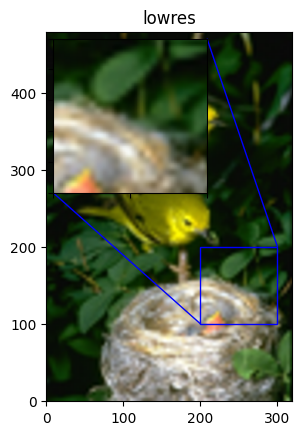

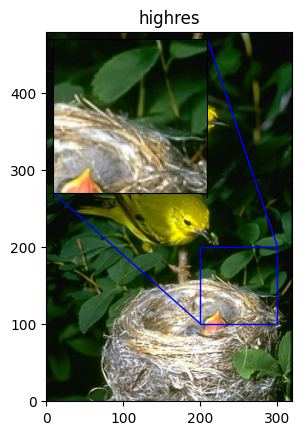

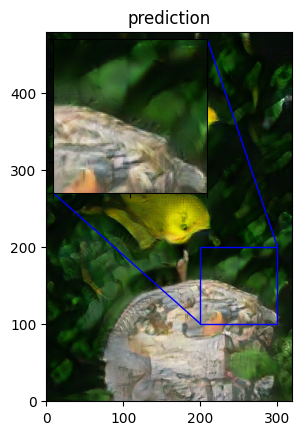

Avg. PSNR of lowres images is 25.6489
Avg. PSNR of reconstructions is 19.6861


In [40]:
total_bicubic_psnr = 0.0
total_test_psnr = 0.0

for index, test_img_path in enumerate(test_img_paths[50:60]):
    img = utils.load_img(test_img_path)
    lowres_input = get_lowres_image(img, upscale_factor)
    w = lowres_input.size[0] * upscale_factor
    h = lowres_input.size[1] * upscale_factor
    highres_img = img.resize((w, h))
    lowres_img = lowres_input.resize((w, h))
    lowres_input_arr = utils.img_to_array(lowres_input)
    prediction = upscale_image(srgan, lowres_input_arr)
    lowres_img_arr = utils.img_to_array(lowres_img)
    highres_img_arr = utils.img_to_array(highres_img)
    predict_img_arr = utils.img_to_array(prediction)
    print(np.max(predict_img_arr), np.min(predict_img_arr))
    bicubic_psnr = tf.image.psnr(lowres_img_arr, highres_img_arr, max_val=255)
    # print(lowres_img_arr.shape, highres_img_arr.shape)
    test_psnr = tf.image.psnr(predict_img_arr, highres_img_arr, max_val=255)

    total_bicubic_psnr += bicubic_psnr
    total_test_psnr += test_psnr

    print(
        "PSNR of low resolution image and high resolution image is %.4f" % bicubic_psnr
    )
    print("PSNR of predict and high resolution is %.4f" % test_psnr)
    plot_results(lowres_img, index, "lowres")
    plot_results(highres_img, index, "highres")
    plot_results(prediction, index, "prediction")

print("Avg. PSNR of lowres images is %.4f" % (total_bicubic_psnr / 10))
print("Avg. PSNR of reconstructions is %.4f" % (total_test_psnr / 10))

In [41]:
import cv2

In [43]:
def prepare_images(path, factor):
    
    # loop through the files in the directory
    for file in os.listdir(path):
        
        # open the file
        img = cv2.imread(path + '/' + file)
        
        # find old and new image dimensions
        h, w, c = img.shape
        new_height = int(h / factor)
        new_width = int(w / factor)
        
        # resize the image - down
        img = cv2.resize(img, (new_width, new_height), interpolation = cv2.INTER_LINEAR) #interploation are methods for resizing images;how do you go from image with 100px to 1000px 
        #bilinear interpolation
        
        # resize the image - up
        img = cv2.resize(img, (w, h), interpolation = cv2.INTER_LINEAR)
        
        # save the image
        print('Saving {}'.format(file))
        cv2.imwrite('images/{}'.format(file), img)

prepare_images('/Users/raunavghosh/Documents/DIP/Project/SRCNN/Set14',4)


Saving foreman.bmp
Saving man.bmp
Saving pepper.bmp
Saving comic.bmp
Saving coastguard.bmp
Saving baboon.bmp
Saving monarch.bmp
Saving flowers.bmp
Saving face.bmp
Saving ppt3.bmp
Saving zebra.bmp
Saving bridge.bmp
Saving barbara.bmp
Saving lenna.bmp
